# Community Detection with InfoMap

In this project, we reproduce the results of  
[**"Maps of random walks on complex networks reveal community structure"**  
by Martin Rosvall and Carl T. Bergstrom (PNAS, 2008)](https://www.pnas.org/doi/epdf/10.1073/pnas.0706851105).

The **InfoMap** algorithm is based on the idea that the probability flow of a *random walk* on a graph serves as a proxy for the flow of information in the real system.  
Community structure emerges by finding a compressed description of this flow: if a random walker tends to remain for long periods within certain sets of nodes, these sets can be described as *modules* (or communities).

Formally, the quality of a partition is measured by the **Map Equation**:

$$
L(M) = q_{\curvearrowright} H(Q) + \sum_{i=1}^{m} p_{i}^{\circlearrowright} H(P_i),
$$

where:
- $q_{\curvearrowright}$ is the probability that the random walk exits a module,  
- $H(Q)$ is the entropy of movements between modules,  
- $p_{i}^{\circlearrowright}$ is the probability of staying within (or exiting) module $i$,  
- $H(P_i)$ is the entropy of movements within module $i$.  

Minimizing $L(M)$ yields the partition that provides the most efficient, information-theoretic description of flows on the network.


## Synthetic Dataset

In [1]:
# rete_sintetica_networkx.py
import networkx as nx
import numpy as np

def planted_partition_sbm(n=500, n_communities=4, pin=0.08, pout=0.006, seed=42):
    """
    Genera una rete tramite Stochastic Block Model (planted partition).
    - n: numero totale di nodi
    - n_communities: numero di blocchi/comunità
    - pin: probabilità di collegamento intra-blocco
    - pout: probabilità di collegamento inter-blocco
    Restituisce: G (networkx Graph), labels (list di etichette di comunità)
    """
    rng = np.random.default_rng(seed)
    sizes = [n // n_communities] * n_communities
    # se n non divisibile, distribuisci i rimanenti
    for i in range(n % n_communities):
        sizes[i] += 1

    # costruiamo la matrice di probabilità p_ij
    p = [[pin if i == j else pout for j in range(n_communities)]
         for i in range(n_communities)]

    G = nx.stochastic_block_model(sizes, p, seed=seed)
    # etichette di comunità per nodo (ordered by node id)
    labels = []
    for block_idx, size in enumerate(sizes):
        labels.extend([block_idx] * size)

    return G, labels

if __name__ == "__main__":
    N=300 #Number of node
    k=4 #Number of communities 
    G, labels = planted_partition_sbm(n=N, n_communities=k, pin=0.08, pout=0.006, seed=123)
    print("Nodes:", G.number_of_nodes(), "Edges:", G.number_of_edges())
    # salva edgelist e le etichette
    nx.write_edgelist(G, "synthetic_edgelist.txt", data=False)
    np.savetxt("synthetic_labels.txt", labels, fmt="%d")


Nodes: 300 Edges: 1140


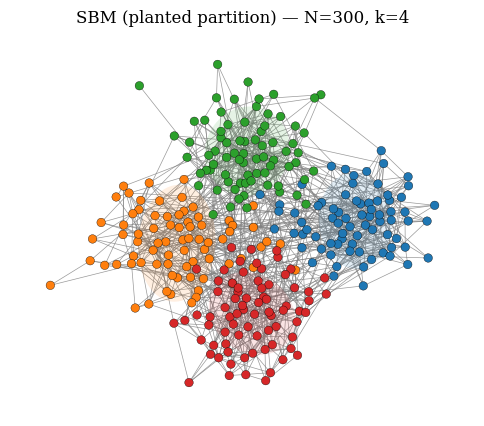

In [2]:
# --- Plot della rete già esistente in G (NetworkX) ---
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import networkx as nx
from matplotlib.patches import Ellipse

def plot_network_G(
    G,
    labels=None,                 # lista di interi (una label per nodo) opzionale
    seed=123,                    # per layout riproducibile
    node_size=38,
    edge_alpha=0.10,
    cmap_name="tab10",
    title="SBM synthetic network",
    save_prefix=None             # es. "sbm_plot"; se None non salva
):
    # stile "da supplementare": font serif, tick inward, linee sottili
    mpl.rcParams.update({
        "font.family": "serif",
        "font.size": 10,
        "axes.titlesize": 12,
        "axes.labelsize": 11,
        "xtick.direction": "in",
        "ytick.direction": "in",
        "legend.frameon": False,
        "axes.linewidth": 0.8,
    })

    # layout riproducibile
    pos = nx.spring_layout(G, seed=seed)

    # colori nodi (per comunità se labels è fornito)
    if labels is not None:
        cmap = plt.get_cmap(cmap_name)
        node_colors = [cmap(l % cmap.N) for l in labels]
    else:
        node_colors = "C0"

    fig, ax = plt.subplots(figsize=(6, 5))

    # edges leggeri
    nx.draw_networkx_edges(
        G, pos, ax=ax, edge_color="gray", alpha=edge_alpha, width=0.5
    )

    # nodes con bordo sottile nero (come spesso nei supplement)
    nx.draw_networkx_nodes(
        G, pos, ax=ax,
        node_color=node_colors,
        node_size=node_size,
        edgecolors="k",
        linewidths=0.25,
    )

    # opzionale: ellissi soffuse attorno alle comunità (solo se labels presenti)
    if labels is not None:
        labels_arr = np.asarray(labels)
        cmap = plt.get_cmap(cmap_name)
        for c in np.unique(labels_arr):
            idx = np.where(labels_arr == c)[0]
            if len(idx) < 4:  # poche coordinate => salta
                continue
            pts = np.array([pos[i] for i in idx])
            centroid = pts.mean(axis=0)
            cov = np.cov(pts.T) + 1e-6*np.eye(2)
            eigvals, eigvecs = np.linalg.eigh(cov)
            w, h = 2.5*np.sqrt(np.maximum(eigvals, 1e-6))
            angle = np.degrees(np.arctan2(eigvecs[1,1], eigvecs[0,1]))
            ax.add_patch(Ellipse(
                xy=centroid, width=w, height=h, angle=angle,
                color=cmap(int(c) % cmap.N), alpha=0.12, linewidth=0
            ))

    ax.set_axis_off()
    ax.set_title(title)

    if save_prefix:
        plt.savefig(f"{save_prefix}.png", dpi=300, bbox_inches="tight")
        plt.savefig(f"{save_prefix}.pdf", bbox_inches="tight")

    plt.show()

# --- usa direttamente G e labels già esistenti ---
plot_network_G(
    G,
    labels=labels,         # se non vuoi colori per comunità, metti None
    seed=123,
    node_size=38,
    edge_alpha=0.8,
    cmap_name="tab10",
    title=f"SBM (planted partition) — N={N}, k={k}",
    save_prefix="sbm_from_existing_G"
)


## Real World Dataset

We used the [Social Connectivity Index (SCI)](https://data.humdata.org/dataset/social-connectedness-index) for the US states (divided by counties)

In [3]:
import math
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from infomap import Infomap
import torch

In [4]:
# Python version of your R plot_network(state)
import math, warnings
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.cm as cm
from matplotlib.colors import Normalize

try:
    import geopandas as gpd
    from shapely.geometry import Point, LineString
    import pygris
except Exception as e:
    gpd = None
    pygris = None
    warnings.warn("Geo stack missing (geopandas/shapely/pyproj/fiona) or pygris not installed. Basemap will be skipped.")

def _node_strength(G, weight="weight"):
    s = {n: 0.0 for n in G.nodes}
    for u, v, d in G.edges(data=True):
        w = float(d.get(weight, 1.0))
        s[u] += w; s[v] += w
    return s

def plot_network_py(
    state_name_or_code,
    G=None,
    graphml_path=None,
    with_labels=False,
    figsize=(12, 10),
    dpi=300,
    save_path=None,
    verbose=True  # flag that determines if the plot is shown or not
):
    if G is None and graphml_path is None:
        raise ValueError("Provide either G or graphml_path.")

    if G is None:
        G = nx.read_graphml(graphml_path)

    if G.number_of_nodes() == 0:
        raise ValueError("Graph has no nodes.")
    n0 = next(iter(G.nodes))
    if "lon" not in G.nodes[n0] or "lat" not in G.nodes[n0]:
        raise ValueError("Nodes must have 'lon' and 'lat' attributes.")
    pos = {n: (float(G.nodes[n]["lon"]), float(G.nodes[n]["lat"])) for n in G.nodes}

    # Node strength -> size/color
    strength = _node_strength(G, weight="weight")
    s_vals = np.array([strength[n] for n in G.nodes], dtype=float)
    s_min, s_max = float(np.min(s_vals)), float(np.max(s_vals))
    norm = Normalize(vmin=s_min, vmax=s_max)
    cmap = plt.get_cmap("RdYlGn_r")
    node_sizes = 100.0 * (s_vals / (s_max + 1e-12))
    node_colors = cmap(norm(s_vals))

    # Edge widths
    if G.number_of_edges() > 0:
        w_raw = np.array([float(d.get("weight", 1.0)) for _, _, d in G.edges(data=True)], dtype=float)
        w_max = float(np.max(w_raw)) if w_raw.size else 1.0
        edge_widths = (5.0 / (w_max + 1e-12)) * w_raw
    else:
        edge_widths = []

    fig, ax = plt.subplots(figsize=figsize, dpi=dpi)

    # Basemap
    if pygris is not None and gpd is not None:
        try:
            counties = pygris.counties(state=state_name_or_code, cb=True, year=2018, cache=True)
            counties = counties.to_crs(4326)
            if str(state_name_or_code).lower() in ("alaska", "ak", "02"):
                counties = counties[counties["GEOID"] != "02016"]
            counties.plot(ax=ax, facecolor="white", edgecolor="black", linewidth=0.3, alpha=1.0)
        except Exception as e:
            if verbose:
                warnings.warn(f"pygris counties failed; continuing without basemap. ({e})")

    # Edges
    if gpd is not None:
        try:
            lines, widths = [], []
            for (u, v), lw in zip(G.edges(), edge_widths):
                if u in pos and v in pos:
                    lines.append(LineString([pos[u], pos[v]])); widths.append(lw)
            if lines:
                edges_gdf = gpd.GeoDataFrame({"linewidth": widths}, geometry=lines, crs="EPSG:4326")
                edges_gdf.plot(ax=ax, linewidth=edges_gdf["linewidth"], alpha=1, color="cornflowerblue")
        except Exception:
            nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color="cornflowerblue", alpha=0.6, ax=ax)
    else:
        nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color="cornflowerblue", alpha=0.6, ax=ax)

    # Nodes
    nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, linewidths=0, ax=ax)

    if with_labels:
        labels = {n: G.nodes[n].get("label", str(n)) for n in G.nodes}
        nx.draw_networkx_labels(G, pos, labels=labels, font_size=7, ax=ax)

    # Colorbar
    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax, orientation="vertical", pad=0.02, fraction=0.046)
    cbar.set_label("Node strength")

    ax.set_aspect("equal", adjustable="datalim")
    ax.set_xlabel("Lon"); ax.set_ylabel("Lat")
    ax.set_title(f"SCI Network {state_name_or_code}")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches="tight")
    if verbose:
        plt.show()
    else:
        plt.close(fig)

In [17]:
G = nx.read_graphml("/Users/gabrielepoccianti/Documents/Information theory and Inference/Project/state_networks_graphml/California.graphml")
H= nx.read_graphml("/Users/gabrielepoccianti/Documents/Information theory and Inference/Project/state_networks_graphml/Texas.graphml")

Using FIPS code '06' for input 'California'


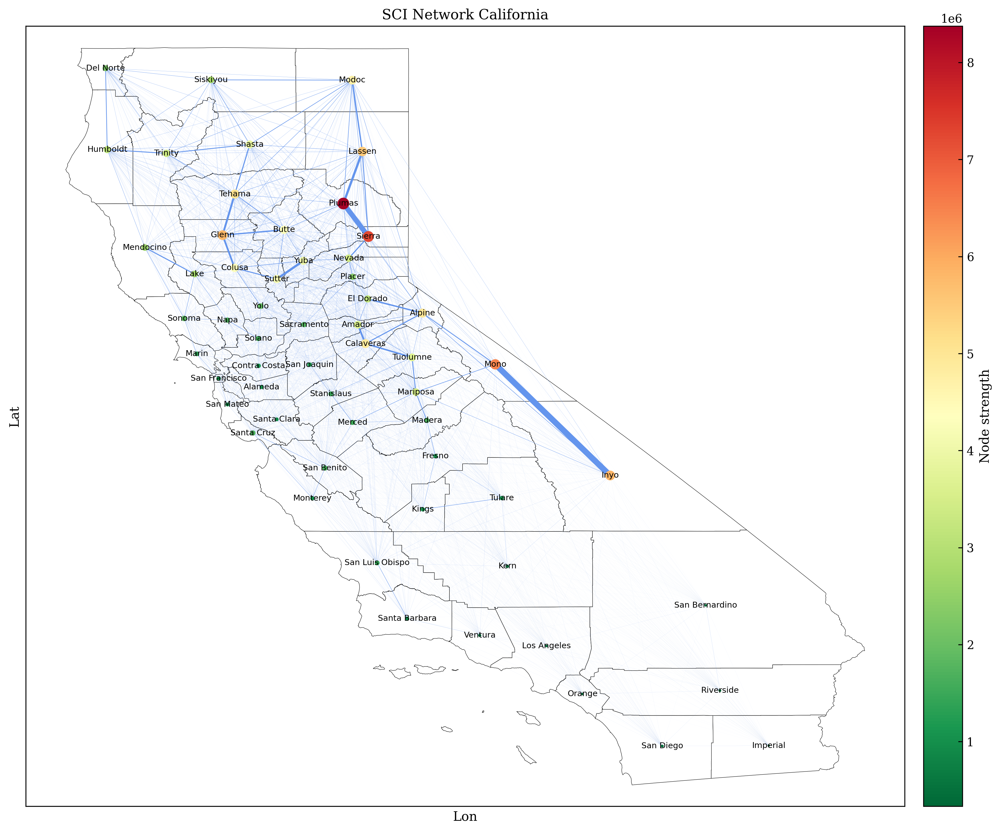

In [6]:
plot_network_py("California", G=G, with_labels=True, dpi=300) #, save_path="California_networkx.png"

Using FIPS code '48' for input 'Texas'


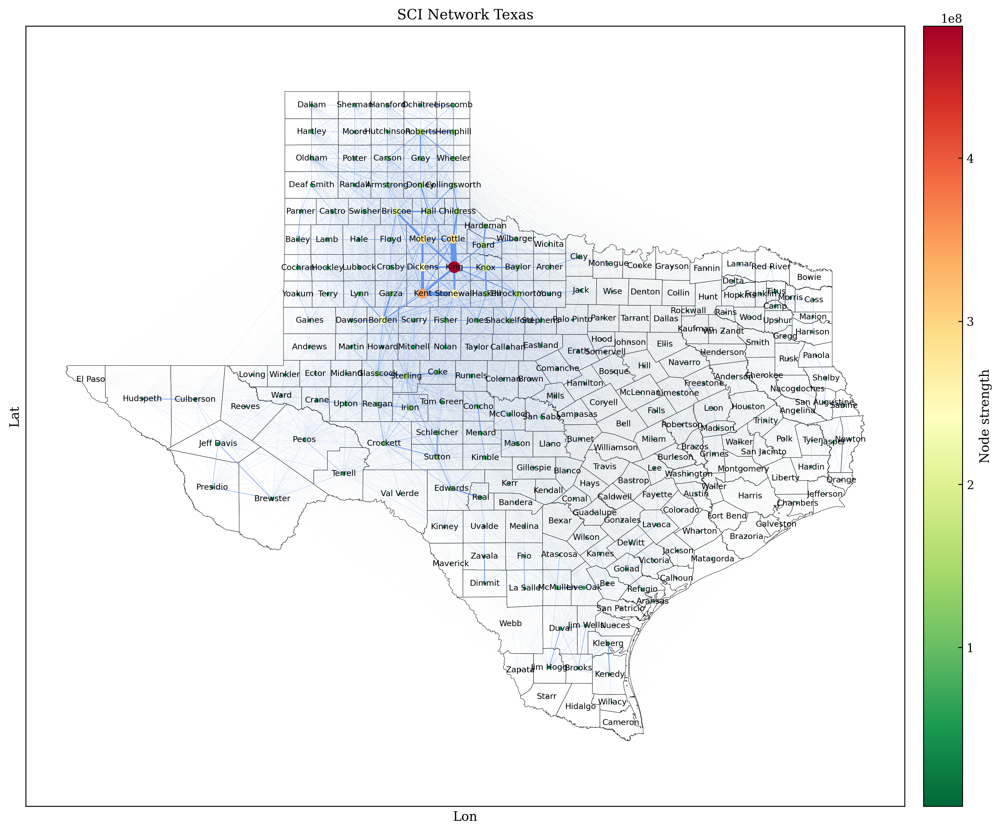

In [7]:
plot_network_py("Texas", G=H, with_labels=True, dpi=300) #, save_path="Texas_networkx.png"

## Testing Infomap

We will now test the already implemented infomap function on the California SCI Network

In [8]:
# %pip install infomap  # if not already installed

import math
import numpy as np
import networkx as nx
from infomap import Infomap

def _sanitize_to_simple_weighted(G):
    """
    Return a new simple Graph/DiGraph with:
      - nodes relabeled to consecutive ints (0..N-1)
      - edges combined (if multiple) by summing weights
      - self-loops removed
      - only finite, non-negative weights kept
    """
    # Collapse to simple graph of same directedness
    H = nx.DiGraph() if G.is_directed() else nx.Graph()

    # Relabel nodes to ints
    mapping = {n: i for i, n in enumerate(G.nodes())}
    inv_mapping = {i: n for n, i in mapping.items()}

    # Aggregate weights
    def ok(w):
        return (w is not None) and np.isfinite(w) and (w >= 0.0)

    if isinstance(G, (nx.MultiGraph, nx.MultiDiGraph)):
        for u, v, d in G.edges(data=True):
            if u == v:
                continue
            w = d.get("weight", 1.0)
            try:
                w = float(w)
            except Exception:
                continue
            if not ok(w):
                continue
            ui, vi = mapping[u], mapping[v]
            if H.has_edge(ui, vi):
                H[ui][vi]["weight"] += w
            else:
                H.add_edge(ui, vi, weight=w)
    else:
        for u, v, d in G.edges(data=True):
            if u == v:
                continue
            w = d.get("weight", 1.0)
            try:
                w = float(w)
            except Exception:
                continue
            if not ok(w):
                continue
            ui, vi = mapping[u], mapping[v]
            if H.has_edge(ui, vi):
                H[ui][vi]["weight"] += w
            else:
                H.add_edge(ui, vi, weight=w)

    # Drop zero-weight edges (Infomap dislikes them)
    zero_edges = [(u, v) for u, v, d in H.edges(data=True) if d.get("weight", 0.0) <= 0.0]
    H.remove_edges_from(zero_edges)

    return H, mapping, inv_mapping

In [9]:
import igraph as ig
"""
def run_infomap_via_igraph(G):
    H, mapping, inv_mapping = _sanitize_to_simple_weighted(G)
    g = ig.Graph(directed=H.is_directed())
    g.add_vertices(H.number_of_nodes())
    w = [d["weight"] for _,_,d in H.edges(data=True)]
    g.add_edges(list(H.edges()))
    g.es["weight"] = w
    # igraph's Infomap uses weights & direction automatically
    comm = g.community_infomap(edge_weights="weight")
    modules = {inv_mapping[i]: int(comm.membership[i]) for i in range(g.vcount())}
    for n, m in modules.items():
        G.nodes[n]["module"] = m
    return modules, comm
    """
def run_infomap_via_igraph(G):
    """Run Infomap using igraph (robust to arbitrary NX node labels). Returns (modules_dict, igraph_clustering)."""
    try:
        import igraph as ig
    except Exception as e:
        raise RuntimeError("python-igraph is required. Install with: pip install python-igraph") from e

    # 1) Sanitize to simple weighted H
    H, mapping, inv_mapping = _sanitize_to_simple_weighted(G)

    # 2) Build a stable node index for igraph (0..N-1), regardless of H's node labels
    nodesH = list(H.nodes())
    idx = {n: i for i, n in enumerate(nodesH)}                 # H-node -> 0..N-1
    inv_idx = {i: n for n, i in idx.items()}                   # 0..N-1 -> H-node

    edges_idx = [(idx[u], idx[v]) for u, v in H.edges()]
    weights = [H[u][v]["weight"] for u, v in H.edges()]

    # 3) Create igraph with correct vertex count and add edges
    g = ig.Graph(directed=H.is_directed())
    g.add_vertices(len(nodesH))                                # vertices 0..N-1
    if edges_idx:
        g.add_edges(edges_idx)
        g.es["weight"] = weights

    # 4) Run Infomap
    comm = g.community_infomap(edge_weights="weight")
    membership = comm.membership  # list indexed by 0..N-1

    # 5) Map membership back to original G labels
    modules = {}
    for i, mod in enumerate(membership):
        h_node = inv_idx[i]            # node label in H
        g_node = inv_mapping[h_node]   # original node label in G
        modules[g_node] = int(mod)

    # annotate original G
    for n, m in modules.items():
        G.nodes[n]["module"] = m

    return modules, comm


In [10]:
modules, comm = run_infomap_via_igraph(G)
print(f"Found {len(set(modules.values()))} modules")
print(f"Codelength (approx): {comm.codelength if hasattr(comm,'codelength') else 'N/A'}")

Found 5 modules
Codelength (approx): 5.727120153710885


In [11]:
modules_Texas, comm_Texas = run_infomap_via_igraph(H)
print(f"Found {len(set(modules_Texas.values()))} modules")
print(f"Codelength (approx): {comm_Texas.codelength if hasattr(comm_Texas,'codelength') else 'N/A'}")

Found 12 modules
Codelength (approx): 7.28449136877278


In [12]:
import math, warnings
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from matplotlib.colors import to_rgba
try:
    import geopandas as gpd
    from shapely.geometry import LineString
    import pygris
except Exception as e:
    gpd = None
    pygris = None
    warnings.warn("Geo stack missing (geopandas/shapely/pyproj/fiona) or pygris not installed. Basemap will be skipped.")

def _node_strength(G, weight="weight"):
    s = {n: 0.0 for n in G.nodes}
    for u, v, d in G.edges(data=True):
        w = float(d.get(weight, 1.0))
        s[u] += w; s[v] += w
    return s

def _distinct_colors(k):
    """
    Return k visually distinct RGBA colors.
    Strategy: concatenate several qualitative palettes, then (if needed)
    fall back to evenly spaced hues.
    """
    pools = ["tab10", "Set3", "Set1", "Set2", "Dark2", "Accent", "Paired", "tab20b", "tab20c"]
    colors = []
    for name in pools:
        cmap = plt.get_cmap(name)
        for i in range(cmap.N):
            colors.append(to_rgba(cmap(i)))
            if len(colors) >= k:
                return colors[:k]
    # Fallback: evenly spaced hues in HSV
    return [plt.cm.hsv(i / max(1, k)) for i in range(k)]

def plot_network_by_module(
    state_name_or_code,
    G=None,
    graphml_path=None,
    with_labels=False,
    figsize=(12, 10),
    dpi=300,
    save_path=None,
    verbose=True  # new flag
):
    if G is None and graphml_path is None:
        raise ValueError("Provide either G or graphml_path.")
    if G is None:
        G = nx.read_graphml(graphml_path)

    if G.number_of_nodes() == 0:
        raise ValueError("Graph has no nodes.")
    n0 = next(iter(G.nodes))
    if "lon" not in G.nodes[n0] or "lat" not in G.nodes[n0]:
        raise ValueError("Nodes must have 'lon' and 'lat' attributes.")
    pos = {n: (float(G.nodes[n]["lon"]), float(G.nodes[n]["lat"])) for n in G.nodes}

    node_sizes = 100
    modules = [G.nodes[n].get("module", -1) for n in G.nodes]
    uniq_modules = sorted(set(modules))
    colors_pool = _distinct_colors(len(uniq_modules))
    mod_to_color = {m: colors_pool[i] for i, m in enumerate(uniq_modules)}
    node_colors = [mod_to_color[m] for m in modules]

    if G.number_of_edges() > 0:
        w_raw = np.array([float(d.get("weight", 1.0)) for _, _, d in G.edges(data=True)], dtype=float)
        w_max = float(np.max(w_raw)) if w_raw.size else 1.0
        edge_widths = (5.0 / (w_max + 1e-12)) * w_raw
    else:
        edge_widths = []

    fig, ax = plt.subplots(figsize=figsize, dpi=dpi)

    if pygris is not None and gpd is not None:
        try:
            counties = pygris.counties(state=state_name_or_code, cb=True, year=2018, cache=True).to_crs(4326)
            if str(state_name_or_code).lower() in ("alaska", "ak", "02"):
                counties = counties[counties["GEOID"] != "02016"]
            counties.plot(ax=ax, facecolor="white", edgecolor="black", linewidth=0.3, alpha=1.0)
        except Exception as e:
            if verbose:
                warnings.warn(f"pygris counties failed; continuing without basemap. ({e})")

    if gpd is not None:
        try:
            lines, widths = [], []
            for (u, v), lw in zip(G.edges(), edge_widths):
                if u in pos and v in pos:
                    lines.append(LineString([pos[u], pos[v]])); widths.append(lw)
            if lines:
                edges_gdf = gpd.GeoDataFrame({"linewidth": widths}, geometry=lines, crs="EPSG:4326")
                edges_gdf.plot(ax=ax, linewidth=edges_gdf["linewidth"], alpha=1, color="cornflowerblue")
        except Exception:
            nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color="cornflowerblue", alpha=0.6, ax=ax)
    else:
        nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color="cornflowerblue", alpha=0.6, ax=ax)

    nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, linewidths=0, ax=ax)

    if with_labels:
        labels = {n: G.nodes[n].get("label", str(n)) for n in G.nodes}
        nx.draw_networkx_labels(G, pos, labels=labels, font_size=7, ax=ax)

    ax.set_aspect("equal", adjustable="datalim")
    ax.set_xlabel("Lon"); ax.set_ylabel("Lat")
    ax.set_title(f"SCI Network {state_name_or_code} (modules)")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches="tight")
    if verbose:
        plt.show()
    else:
        plt.close(fig)

Using FIPS code '06' for input 'California'


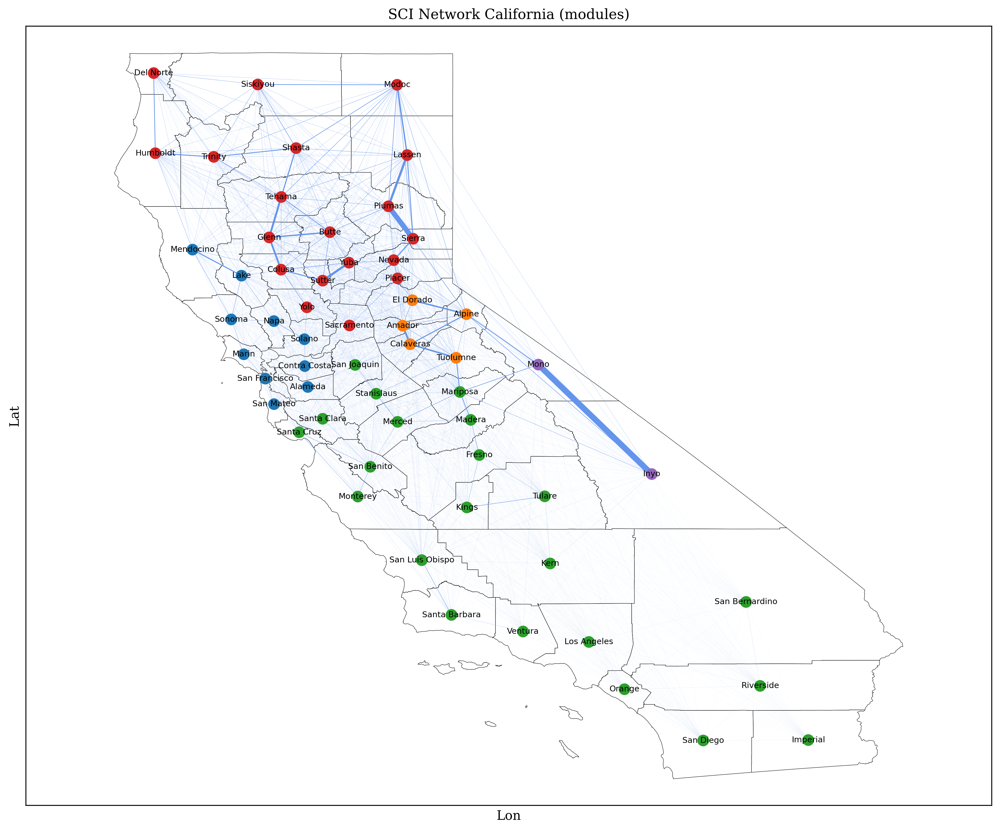

In [13]:
plot_network_by_module("California", G, with_labels=True) #, save_path="california_modules.png"

Using FIPS code '48' for input 'Texas'


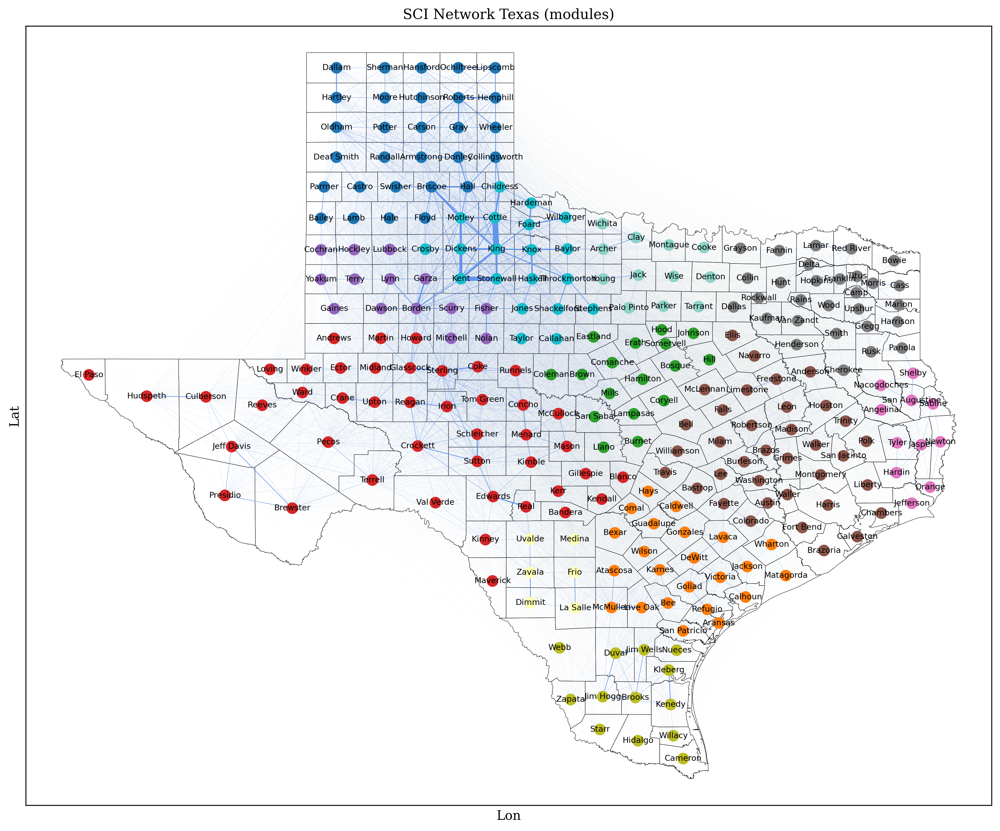

In [14]:
plot_network_by_module("Texas", H, with_labels=True) #, save_path="texas_modules.png"

## Repeat the procedure for all states

In [16]:
# --- Batch: save strength plot and clusters plot for each state ---
# Prereqs: plot_network_py(), plot_network_by_module(), run_infomap_via_igraph()

import os
from pathlib import Path
import networkx as nx

# Your source directory with .graphml files
GRAPHML_DIR = Path("/Users/gabrielepoccianti/Documents/Information theory and Inference/Project/state_networks_graphml/")

# Output directories
OUT_STRENGTH = Path("strength_plots")
OUT_CLUSTERS = Path("clusters_plots")
OUT_STRENGTH.mkdir(parents=True, exist_ok=True)
OUT_CLUSTERS.mkdir(parents=True, exist_ok=True)

# Suppress or show logs and plots
verbose = False  # set to False for silent saving (no logs, no plt.show())

# Discover all states
graphml_files = sorted(GRAPHML_DIR.glob("*.graphml"))
if not graphml_files:
    raise FileNotFoundError(f"No .graphml files found in {GRAPHML_DIR}")

for path in graphml_files:
    state = path.stem  # filename without extension, used as state name

    # Load graph
    G = nx.read_graphml(path)

    # 1) Strength plot (with labels) -> save
    save_strength = OUT_STRENGTH / f"{state}_networkx.png"
    if verbose:
        print(f"[strength] {state} -> {save_strength}")
    plot_network_py(state, G=G, with_labels=True, save_path=str(save_strength), verbose=verbose)

    # 2) Infomap (adds G.nodes[n]['module'])
    modules, comm = run_infomap_via_igraph(G)
    if verbose:
        num_modules = len(set(modules.values()))
        codelength = getattr(comm, "codelength", None)
        if codelength is not None:
            print(f"[infomap]  {state}: modules={num_modules}, codelength={codelength:.4f}")
        else:
            print(f"[infomap]  {state}: modules={num_modules}")

    # 3) Cluster plot (with labels) -> save
    save_clusters = OUT_CLUSTERS / f"{state}_clusters.png"
    if verbose:
        print(f"[clusters] {state} -> {save_clusters}")
    plot_network_by_module(state, G=G, with_labels=True, save_path=str(save_clusters), verbose=verbose)

Using FIPS code '01' for input 'Alabama'
Using FIPS code '01' for input 'Alabama'
Using FIPS code '02' for input 'Alaska'
Using FIPS code '02' for input 'Alaska'
Using FIPS code '04' for input 'Arizona'
Using FIPS code '04' for input 'Arizona'
Using FIPS code '05' for input 'Arkansas'
Using FIPS code '05' for input 'Arkansas'
Using FIPS code '06' for input 'California'
Using FIPS code '06' for input 'California'
Using FIPS code '08' for input 'Colorado'
Using FIPS code '08' for input 'Colorado'
Using FIPS code '09' for input 'Connecticut'
Using FIPS code '09' for input 'Connecticut'
Using FIPS code '10' for input 'Delaware'
Using FIPS code '10' for input 'Delaware'
Using FIPS code '13' for input 'Georgia'
Using FIPS code '13' for input 'Georgia'
Using FIPS code '15' for input 'Hawaii'
Using FIPS code '15' for input 'Hawaii'
Using FIPS code '17' for input 'Illinois'
Using FIPS code '17' for input 'Illinois'
Using FIPS code '18' for input 'Indiana'
Using FIPS code '18' for input 'Indiana

## Produce a Dataset for further ML Analysis

For now we assume that we will threat only UNDIRECTED NETWORKS

In [18]:
# --- Build PyG datasets for each state and save to Networks_datasets/ ---

from pathlib import Path
import numpy as np
import torch
import networkx as nx

GRAPHML_DIR = Path("/Users/gabrielepoccianti/Documents/Information theory and Inference/Project/state_networks_graphml/")
OUT_DIR = Path("Networks_datasets")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# ---------- Helpers ----------
def _sanitize_to_simple_weighted_undirected(G: nx.Graph) -> tuple[nx.Graph, dict, dict]:
    """
    Simple weighted undirected Graph, finite non-negative weights, no self-loops.
    Returns (H, mapping, inv_mapping).
    """
    # forza a non diretto
    if G.is_directed():
        G = G.to_undirected()

    H = nx.Graph()
    mapping = {n: i for i, n in enumerate(G.nodes())}
    inv_mapping = {i: n for n, i in mapping.items()}

    def ok(w): return (w is not None) and np.isfinite(w) and (w >= 0.0)

    for u, v, d in G.edges(data=True):
        if u == v:
            continue
        try:
            w = float(d.get("weight", 1.0))
        except Exception:
            continue
        if not ok(w):
            continue
        ui, vi = mapping[u], mapping[v]
        if H.has_edge(ui, vi):
            H[ui][vi]["weight"] += w
        else:
            H.add_edge(ui, vi, weight=w)

    # drop zero-weight edges & keep isolated nodes
    H.remove_edges_from([(u, v) for u, v, dat in H.edges(data=True) if dat.get("weight", 0.0) <= 0.0])
    H.add_nodes_from(mapping.values())
    return H, mapping, inv_mapping

def run_infomap_via_igraph(G: nx.Graph):
    """Infomap via igraph su grafo non diretto pesato; ritorna (modules_dict, ig_clustering)."""
    import igraph as ig
    H, mapping, inv_mapping = _sanitize_to_simple_weighted_undirected(G)

    nodesH = list(H.nodes())
    idx = {n: i for i, n in enumerate(nodesH)}    # H-node -> 0..N-1
    inv_idx = {i: n for n, i in idx.items()}

    edges_idx = [(idx[u], idx[v]) for u, v in H.edges()]
    weights = [H[u][v]["weight"] for u, v in H.edges()]

    g = ig.Graph(directed=False)
    g.add_vertices(len(nodesH))
    if edges_idx:
        g.add_edges(edges_idx)
        g.es["weight"] = weights

    comm = g.community_infomap(edge_weights="weight")
    membership = comm.membership

    # Map back to original G labels
    modules = {}
    for i, mod in enumerate(membership):
        h_node = inv_idx[i]
        g_node = inv_mapping[h_node]
        modules[g_node] = int(mod)

    return modules, comm

def _minmax(a):
    a = np.asarray(a, dtype=np.float32)
    mn, mx = np.min(a), np.max(a)
    return (a - mn) / (mx - mn + 1e-9) if mx > mn else np.zeros_like(a, dtype=np.float32)

def nx_to_pyg_data(G: nx.Graph, state_name: str, modules: dict | None, use_weighted_clustering: bool = True):
    """
    PyG-like Data per grafi NON DIRETTI PESATI, senza feature geografiche.
    Feature (tutte generalizzabili):
      - degree
      - strength (somma pesi archi incidenti)
      - clustering locale (pesato se use_weighted_clustering=True, altrimenti non pesato)
    Tutte min–max normalizzate per grafo; il clustering è già in [0,1].
    """
    # forza a non diretto
    if G.is_directed():
        G = G.to_undirected()

    # nodo order stabile
    nodes = list(G.nodes())
    idx = {n: i for i, n in enumerate(nodes)}
    N = len(nodes)

    # assicurati che esista un peso su ogni arco
    for _, _, d in G.edges(data=True):
        if "weight" not in d:
            d["weight"] = 1.0

    # degree e strength
    deg = np.array([float(G.degree(n)) for n in nodes], dtype=np.float32)
    strength = np.zeros(N, dtype=np.float32)
    for u, v, d in G.edges(data=True):
        w = float(d.get("weight", 1.0))
        iu, iv = idx[u], idx[v]
        strength[iu] += w
        strength[iv] += w

    # clustering locale (in [0,1])
    if use_weighted_clustering:
        cdict = nx.clustering(G, weight="weight")
    else:
        cdict = nx.clustering(G, weight=None)
    clustering = np.array([float(cdict[n]) for n in nodes], dtype=np.float32)

    # normalizzazioni
    deg_n = _minmax(deg)
    str_n = _minmax(strength)
    # clustering già in [0,1]

    x = torch.tensor(np.vstack([deg_n, str_n, clustering]).T, dtype=torch.float)  # [N,3]

    # edge_index (bidirezionale per PyG anche se il grafo è non diretto)
    rows, cols, wts = [], [], []
    for u, v, d in G.edges(data=True):
        i, j = idx[u], idx[v]
        w = float(d.get("weight", 1.0))
        rows += [i, j]
        cols += [j, i]
        wts  += [w, w]
    edge_index = torch.tensor([rows, cols], dtype=torch.long) if rows else torch.empty((2,0), dtype=torch.long)
    edge_weight = torch.tensor(wts, dtype=torch.float) if wts else torch.empty((0,), dtype=torch.float)

    # labels: remappa moduli -> 0..K-1 per-grafo
    if modules is None:
        y = torch.full((N,), -1, dtype=torch.long)
    else:
        lab = [modules.get(n, -1) for n in nodes]
        uniq = sorted({m for m in lab if m != -1})
        remap = {m: i for i, m in enumerate(uniq)}
        y = torch.tensor([remap.get(m, -1) for m in lab], dtype=torch.long)

    data = {
        "x": x,
        "edge_index": edge_index,
        "edge_weight": edge_weight,
        "y": y,
        "state_name": state_name,
        # niente pos / geo
    }
    # PyG Data-like semplice (evita import se PyG non è installato)
    class SimpleData:
        def __init__(self, d): self.__dict__.update(d)
    return SimpleData(data)

# ---------- Main loop ----------
graphml_files = sorted(GRAPHML_DIR.glob("*.graphml"))
if not graphml_files:
    raise FileNotFoundError(f"No .graphml files found in {GRAPHML_DIR}")

for path in graphml_files:
    state = path.stem
    try:
        G = nx.read_graphml(path)

        # forza a non diretto e assicurati dei pesi
        if G.is_directed():
            G = G.to_undirected()
        for _, _, d in G.edges(data=True):
            if "weight" not in d:
                d["weight"] = 1.0

        # Infomap per le label
        modules, _ = run_infomap_via_igraph(G)

        # build Data (niente geo)
        data = nx_to_pyg_data(G, state, modules, use_weighted_clustering=True)

        # save
        out_path = OUT_DIR / f"{state}.pt"
        torch.save(data.__dict__, out_path)
        print(f"[OK] {state} -> {out_path}")

    except Exception as e:
        print(f"[ERROR] {state}: {e}")


[OK] 78 -> Networks_datasets/78.pt
[OK] Alabama -> Networks_datasets/Alabama.pt
[OK] Alaska -> Networks_datasets/Alaska.pt
[OK] American_Samoa -> Networks_datasets/American_Samoa.pt
[OK] Arizona -> Networks_datasets/Arizona.pt
[OK] Arkansas -> Networks_datasets/Arkansas.pt
[OK] California -> Networks_datasets/California.pt
[OK] Colorado -> Networks_datasets/Colorado.pt
[OK] Connecticut -> Networks_datasets/Connecticut.pt
[OK] Delaware -> Networks_datasets/Delaware.pt
[OK] Georgia -> Networks_datasets/Georgia.pt
[OK] Hawaii -> Networks_datasets/Hawaii.pt
[OK] Illinois -> Networks_datasets/Illinois.pt
[OK] Indiana -> Networks_datasets/Indiana.pt
[OK] Iowa -> Networks_datasets/Iowa.pt
[OK] Kansas -> Networks_datasets/Kansas.pt
[OK] Kentucky -> Networks_datasets/Kentucky.pt
[OK] Louisiana -> Networks_datasets/Louisiana.pt
[OK] Maine -> Networks_datasets/Maine.pt
[OK] Maryland -> Networks_datasets/Maryland.pt
[OK] Massachusetts -> Networks_datasets/Massachusetts.pt
[OK] Michigan -> Networks

## Clustering Prediction with a GNN

In [27]:
# Prefer CUDA if available, else MPS (Apple Silicon), else CPU
if torch.cuda.is_available():
    DEVICE = torch.device("cuda")
elif torch.backends.mps.is_available():
    DEVICE = torch.device("mps")
else:
    DEVICE = torch.device("cpu")
    
print("Device:", DEVICE)

Device: mps


### Load Datasets

In [28]:
# Cell 1: imports & seed
import os
from pathlib import Path
import numpy as np
import torch
from torch import nn
from torch.utils.data import random_split

# PyG
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader
from torch_geometric.nn import GCNConv
from torch_geometric.utils import degree

# riproducibilità ragionevole
SEED = 42
rng = np.random.default_rng(SEED)
torch.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False



In [29]:
# Cell 2: load dataset of states
DATA_DIR = Path("Networks_datasets")
assert DATA_DIR.exists(), f"Cartella non trovata: {DATA_DIR.resolve()}"

graphs = []
for p in sorted(DATA_DIR.glob("*.pt")):
    obj = torch.load(p, map_location='cpu')
    # obj è un dict con chiavi: x, edge_index, edge_weight, y, pos, state_name
    data = Data(
        x=obj["x"],
        edge_index=obj["edge_index"],
        edge_weight=obj.get("edge_weight", None),
        y=obj["y"],
        pos=obj.get("pos", None),
    )
    data.state_name = obj.get("state_name", p.stem)
    # Fix: assicuriamoci che y sia long e che ci sia almeno una classe
    data.y = data.y.long()
    graphs.append(data)

print(f"Caricati {len(graphs)} grafi.")
print([g.state_name for g in graphs[:5]])

Caricati 52 grafi.
['78', 'Alabama', 'Alaska', 'American_Samoa', 'Arizona']


In [30]:
# Cell 3: utility per loss masking e class weights
def labeled_mask(y: torch.Tensor):
    # y == -1 => non etichettato
    return (y >= 0)

def class_weights_for_graph(y: torch.Tensor):
    """Calcola pesi inversamente proporzionali alla frequenza delle classi (solo tra etichette valide)."""
    m = labeled_mask(y)
    yv = y[m]
    if yv.numel() == 0:
        return None
    num_classes = int(yv.max().item()) + 1
    counts = torch.bincount(yv, minlength=num_classes).float()
    # evitiamo divisioni per zero
    counts[counts == 0] = 1.0
    w = 1.0 / counts
    w = w * (num_classes / w.sum())  # normalizzazione dolce
    return w

## Model definition

In [31]:
# Cell 4: modello GCN semplice
class GCNInfomap(nn.Module):
    def __init__(self, in_dim: int, hidden: int, out_dim: int, dropout: float = 0.5):
        super().__init__()
        self.conv1 = GCNConv(in_dim, hidden, add_self_loops=True, normalize=True)
        self.conv2 = GCNConv(hidden, out_dim, add_self_loops=True, normalize=True)
        self.dropout = nn.Dropout(dropout)
        self.act = nn.ReLU()

    def forward(self, x, edge_index, edge_weight=None):
        x = self.conv1(x, edge_index, edge_weight=edge_weight)
        x = self.act(x)
        x = self.dropout(x)
        x = self.conv2(x, edge_index, edge_weight=edge_weight)
        return x

In [32]:
# Cell 5: determinazione feature e numero classi massimo tra i grafi
in_dim = graphs[0].x.size(1)
max_classes = 1
for g in graphs:
    m = labeled_mask(g.y)
    if m.sum() == 0:
        continue
    max_classes = max(max_classes, int(g.y[m].max().item()) + 1)

print(f"Input dim = {in_dim}, max num classes across graphs = {max_classes}")

Input dim = 3, max num classes across graphs = 12


## Training (no validation for now)

In [33]:
# Cell 6: DataLoader
BATCH_SIZE = 1  # addestriamo per-grafo (robusto al fatto che le classi siano per-grafo)
loader = DataLoader(graphs, batch_size=BATCH_SIZE, shuffle=True)
len(loader)

52

In [34]:
# Cell 7: training setup
HIDDEN = 64
DROPOUT = 0.5
LR = 1e-3
WEIGHT_DECAY = 5e-4
EPOCHS = 200

model = GCNInfomap(in_dim, HIDDEN, max_classes, dropout=DROPOUT).to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
criterion = nn.CrossEntropyLoss(reduction='mean')  # pesi classi per-grafo gestiti a mano

print(sum(p.numel() for p in model.parameters()), "parametri")

1036 parametri


In [36]:
# Cell 8 (VAR-K): training loop che gestisce K_g variabile per grafo
from collections import defaultdict

def train_one_epoch():
    model.train()
    total_loss = 0.0
    total_nodes = 0

    for batch in loader:  # batch_size=1 => un grafo alla volta
        batch = batch.to(DEVICE)

        logits = model(batch.x, batch.edge_index, edge_weight=getattr(batch, 'edge_weight', None))
        y = batch.y
        m = (y >= 0)  # nodi etichettati

        if m.sum() == 0:
            continue

        # Numero di classi del GRAFO corrente
        K_g = int(y[m].max().item()) + 1

        # taglia i logits a [*, K_g] e le etichette a [0..K_g-1]
        logits_g = logits[m, :K_g]
        y_g = y[m]

        # pesi di classe per-grafo (lunghezza K_g)
        w = class_weights_for_graph(y)
        if w is not None:
            # w è calcolato solo sulle classi presenti => lunghezza K_g
            loss_fn = nn.CrossEntropyLoss(weight=w.to(DEVICE), reduction='mean')
        else:
            loss_fn = criterion  # senza pesi

        loss = loss_fn(logits_g, y_g)

        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        optimizer.step()

        total_loss += loss.item() * int(m.sum())
        total_nodes += int(m.sum())

    return total_loss / max(total_nodes, 1)


@torch.no_grad()
def evaluate_accuracy_f1():
    from sklearn.metrics import f1_score

    model.eval()
    accs, f1_macros = [], []
    for g in graphs:
        gg = g.to(DEVICE)
        logits = model(gg.x, gg.edge_index, edge_weight=getattr(gg, 'edge_weight', None))
        y = gg.y.detach().cpu()
        m = (y >= 0)
        if m.sum() == 0:
            continue
        K_g = int(y[m].max().item()) + 1
        # predizione solo sulle prime K_g colonne
        pred = logits.detach().cpu()[:, :K_g].argmax(dim=-1)

        accs.append((pred[m] == y[m]).float().mean().item())
        y_true = y[m].numpy()
        y_pred = pred[m].numpy()
        f1_macros.append(f1_score(y_true, y_pred, average='macro', zero_division=0))

    mean_acc = float(np.mean(accs)) if accs else 0.0
    mean_f1 = float(np.mean(f1_macros)) if f1_macros else 0.0
    return mean_acc, mean_f1


# training
history = {"loss": [], "acc": [], "f1": []}
for epoch in range(1, EPOCHS + 1):
    loss = train_one_epoch()
    acc, f1 = evaluate_accuracy_f1()
    history["loss"].append(loss)
    history["acc"].append(acc)
    history["f1"].append(f1)
    if epoch % 10 == 0 or epoch == 1:
        print(f"[{epoch:03d}] loss={loss:.4f}  acc={acc:.3f}  f1_macro={f1:.3f}")

[001] loss=1.7844  acc=0.450  f1_macro=0.376
[010] loss=1.7792  acc=0.440  f1_macro=0.385
[020] loss=1.7793  acc=0.425  f1_macro=0.381
[030] loss=1.7768  acc=0.426  f1_macro=0.379
[040] loss=1.7753  acc=0.425  f1_macro=0.382
[050] loss=1.7748  acc=0.425  f1_macro=0.386
[060] loss=1.7791  acc=0.424  f1_macro=0.372
[070] loss=1.7759  acc=0.426  f1_macro=0.384
[080] loss=1.7753  acc=0.436  f1_macro=0.383
[090] loss=1.7737  acc=0.435  f1_macro=0.383
[100] loss=1.7748  acc=0.430  f1_macro=0.385
[110] loss=1.7729  acc=0.431  f1_macro=0.386
[120] loss=1.7738  acc=0.431  f1_macro=0.390
[130] loss=1.7713  acc=0.429  f1_macro=0.381
[140] loss=1.7724  acc=0.441  f1_macro=0.390
[150] loss=1.7704  acc=0.421  f1_macro=0.376
[160] loss=1.7725  acc=0.433  f1_macro=0.380
[170] loss=1.7741  acc=0.435  f1_macro=0.385
[180] loss=1.7734  acc=0.438  f1_macro=0.387
[190] loss=1.7701  acc=0.427  f1_macro=0.377
[200] loss=1.7713  acc=0.441  f1_macro=0.390


In [37]:
# Cell 9: save model & print final metrics
MODEL_DIR = Path("trained_models"); MODEL_DIR.mkdir(exist_ok=True, parents=True)
model_path = MODEL_DIR / "gcn_infomap.pt"
torch.save({"model_state": model.state_dict(),
            "in_dim": in_dim,
            "hidden": HIDDEN,
            "out_dim": max_classes,
            "dropout": DROPOUT}, model_path)
print("Modello salvato in:", model_path.resolve())

final_acc, final_f1 = evaluate_accuracy_f1()
print(f"Finale => acc={final_acc:.3f}, f1_macro={final_f1:.3f}")

Modello salvato in: /Users/gabrielepoccianti/Documents/Information theory and Inference/Project/trained_models/gcn_infomap.pt
Finale => acc=0.441, f1_macro=0.390


In [38]:
# Cell 10 (VAR-K): predizioni per stato con K_g variabile
@torch.no_grad()
def predict_graph_varK(data):
    model.eval()
    logits = model(data.x.to(DEVICE), data.edge_index.to(DEVICE),
                   edge_weight=getattr(data, 'edge_weight', None).to(DEVICE) if getattr(data, 'edge_weight', None) is not None else None)
    y = data.y.cpu()
    m = (y >= 0)
    if m.sum() == 0:
        # se non hai etichette, usa tutte le colonne disponibili
        return logits.argmax(dim=-1).cpu()
    K_g = int(y[m].max().item()) + 1
    # argmax limitato a K_g
    return logits[:, :K_g].argmax(dim=-1).cpu()

PRED_DIR = Path("predictions"); PRED_DIR.mkdir(exist_ok=True, parents=True)
for g in graphs:
    yhat = predict_graph_varK(g)
    out = {
        "state_name": g.state_name,
        "y_true": g.y.cpu(),
        "y_pred": yhat,
        "num_nodes": g.num_nodes,
    }
    torch.save(out, PRED_DIR / f"{g.state_name}_pred.pt")
print("Predizioni salvate in:", PRED_DIR.resolve())

Predizioni salvate in: /Users/gabrielepoccianti/Documents/Information theory and Inference/Project/predictions
